# Gecco Challenge - Inspection and EDA


# Import Libraries

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


## Loading the data


In [3]:
data_raw_path = "../data/raw/waterDataTraining.csv"

# Load the dataset
df = pd.read_csv(data_raw_path)

## Data Inspection

### Basic DIs

In [4]:
df.head()

,Time,Tp,Cl,pH,Redox,Leit,Trueb,Cl_2,Fm,Fm_2,EVENT
0,2016-08-03T09:49:00Z,6.5,0.17,8.36,749.0,211.0,0.011,0.118,1677.0,695.0,False
1,2016-08-03T09:50:00Z,6.5,0.17,8.36,749.0,211.0,0.011,0.118,1561.0,696.0,False
2,2016-08-03T09:51:00Z,6.5,0.17,8.35,749.0,211.0,0.011,0.117,1581.0,696.0,False
3,2016-08-03T09:52:00Z,6.5,0.17,8.35,749.0,211.0,0.011,0.118,1579.0,693.0,False
4,2016-08-03T09:53:00Z,6.5,0.17,8.35,749.0,211.0,0.011,0.118,1567.0,689.0,False


In [5]:
df.tail()

,Time,Tp,Cl,pH,Redox,Leit,Trueb,Cl_2,Fm,Fm_2,EVENT
139561,2016-11-08T07:50:00Z,10.1,0.16,8.41,762.0,189.0,0.023,0.105,1799.0,924.0,False
139562,2016-11-08T07:51:00Z,10.1,0.17,8.41,762.0,190.0,0.022,0.106,1835.0,927.0,False
139563,2016-11-08T07:52:00Z,10.1,0.17,8.41,762.0,190.0,0.022,0.106,1807.0,924.0,False
139564,2016-11-08T07:53:00Z,10.1,0.17,8.41,762.0,190.0,0.022,0.106,1799.0,930.0,False
139565,2016-11-08T07:54:00Z,10.1,0.17,8.41,762.0,189.0,0.022,0.106,1817.0,925.0,False


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 139566 entries, 0 to 139565
Data columns (total 11 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    139566 non-null  object 
 1   Tp      138522 non-null  float64
 2   Cl      138521 non-null  float64
 3   pH      138522 non-null  float64
 4   Redox   138522 non-null  float64
 5   Leit    138522 non-null  float64
 6   Trueb   138522 non-null  float64
 7   Cl_2    138522 non-null  float64
 8   Fm      138522 non-null  float64
 9   Fm_2    138522 non-null  float64
 10  EVENT   139566 non-null  bool   
dtypes: bool(1), float64(9), object(1)
memory usage: 10.8+ MB


In [8]:
df.shape

(139566, 11)

In [9]:
df.columns

Index(['Time', 'Tp', 'Cl', 'pH', 'Redox', 'Leit', 'Trueb', 'Cl_2', 'Fm',
       'Fm_2', 'EVENT'],
      dtype='object')

In [10]:
df.dtypes

Time      object
Tp       float64
Cl       float64
pH       float64
Redox    float64
Leit     float64
Trueb    float64
Cl_2     float64
Fm       float64
Fm_2     float64
EVENT       bool
dtype: object

#### Summary statistics for numeric columns

In [7]:
df.describe()

,Tp,Cl,pH,Redox,Leit,Trueb,Cl_2,Fm,Fm_2
count,138522.000000,138521.000000,138522.000000,138522.000000,138522.000000,138522.000000,138522.000000,138522.000000,138522.000000
mean,8.521406,0.165482,8.366416,752.899009,209.520998,0.019778,0.106099,1534.208891,927.728014
std,1.281314,0.010207,0.101624,12.945284,7.747497,0.005492,0.007132,208.171011,147.447430
min,0.000000,0.000000,4.000000,300.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,7.500000,0.160000,8.340000,751.000000,209.000000,0.016000,0.103000,1388.000000,847.000000
50%,8.400000,0.170000,8.370000,754.000000,211.000000,0.018000,0.106000,1512.000000,925.000000
75%,9.500000,0.170000,8.390000,756.000000,211.000000,0.023000,0.110000,1650.000000,1000.000000
max,11.800000,0.800000,8.936228,895.000000,646.000000,0.254000,0.462000,3923.000000,2592.000000


##### Interpretation from statistics

- Count
   1. All columns have 138522 entries, except `Cl` which has 138521, indicating a missing values.
- Mean
   1. The average temperature (`Tp`) is approximately 8.52°C, that means a generally mild climate in the dataset's context
- Standard Deviation (std)
   1. `Redox` has a std of 12.945, relatively low, indicating that most redox potential measurements are close to the mean (752.899)
- Min
   2. The minimum pH level recorded is 4.00, which is quite acidic and could indicate extreme conditions or measurement errors, considering the rest of the data.
- 25%
   1. We can see that 25% of temperature readings are below 7.5°C.
- 50%
   1. The median pH is 8.37, very close to the mean (8.36), suggesting a symmetric distribution around the central value.
- 75%
   1. 75% of `Leit` measurements are below 211 µS/cm, indicating most water conductivity measurements are tightly grouped.
- MAx
   1. The max value of `Cl` is 0.800 mg/L, which is significantly higher than the 75% (0.170), suggesting outliers or exceptional cases

#### Checking for Missing Values

In [11]:
df.isnull().sum()

Time        0
Tp       1044
Cl       1045
pH       1044
Redox    1044
Leit     1044
Trueb    1044
Cl_2     1044
Fm       1044
Fm_2     1044
EVENT       0
dtype: int64

### Plotting Basic Graphs

Since the goal is about monitoring water quality, parameters like `pH`, turbidity (`Trueb`), and chlorine dioxide levels (`Cl`, `Cl_2`) might be especially relevant.

#### 1. Time Series Plots

Since the dataset includes a time component, it's essential to visualize how different metrics evolve over time. This can highlight trends cycles, and anomalies.

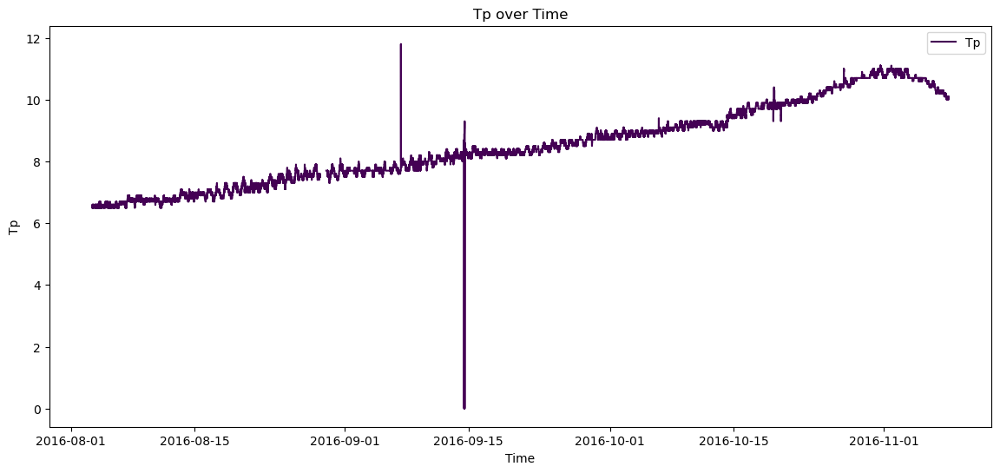

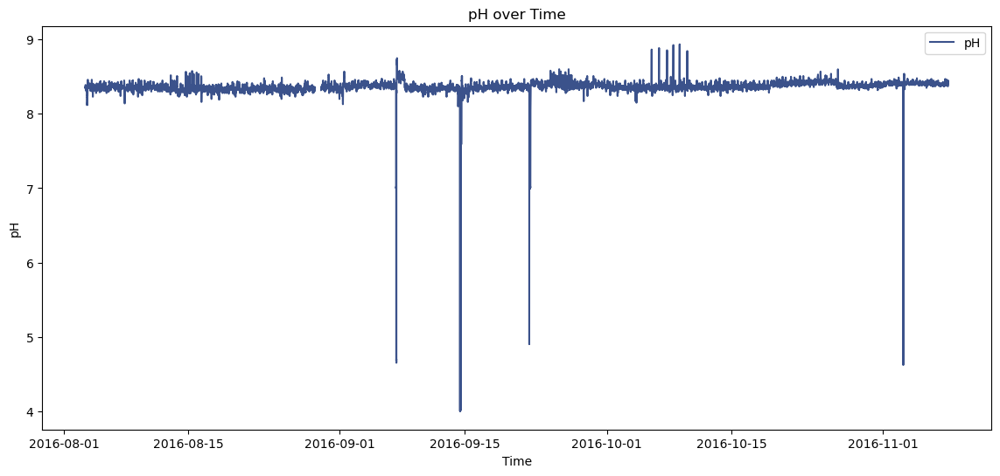

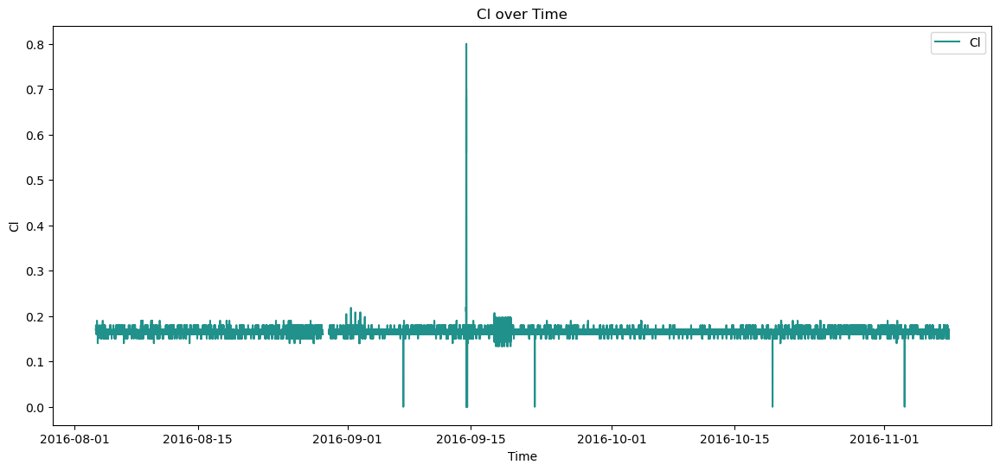

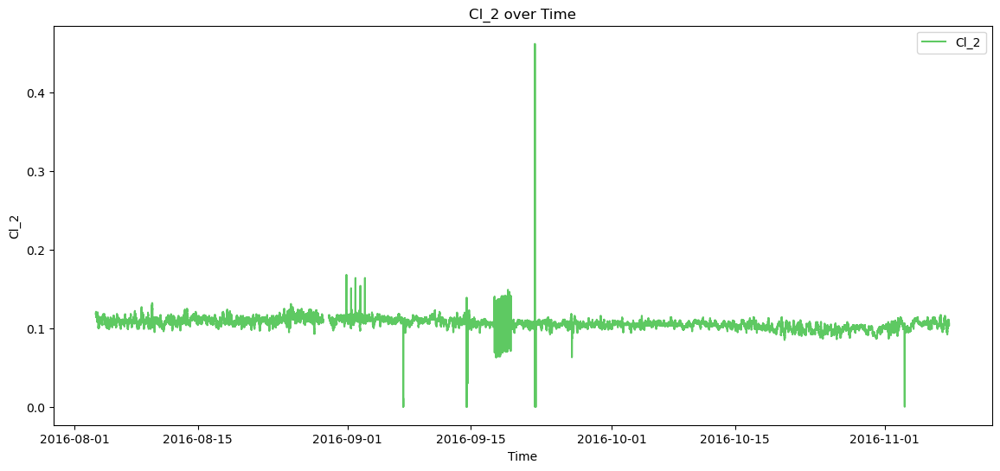

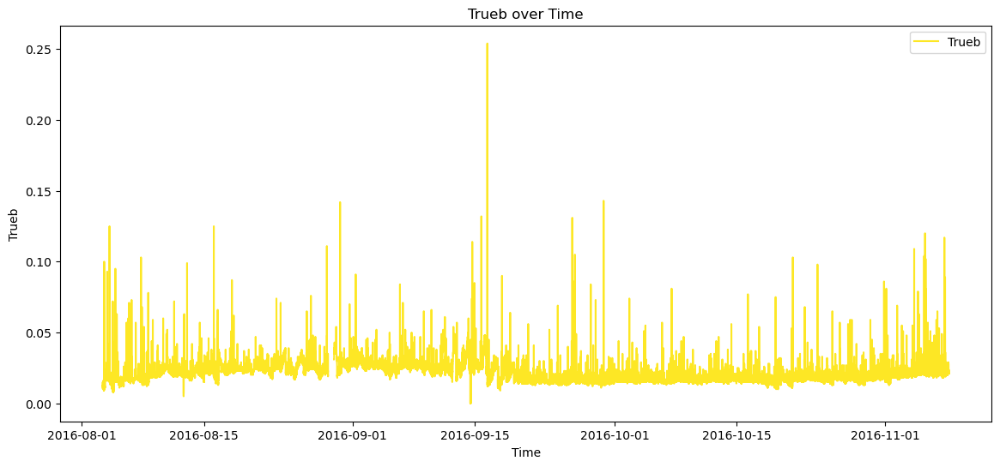

In [12]:
def plot_time_series(df, columns, time_column='Time'):
    """
    This function creates a time series plot for each specified column in the dataframe.

    Parameters:
    df (pd.DataFrame): The dataframe containing the data.
    columns (list of str): List of column names to create time series plots for.
    time_column (str): The column name which contains the time data.

    Returns:
    None
    """
    # Convert 'Time' to datetime format for better plotting, if not already done
    if not pd.api.types.is_datetime64_any_dtype(df[time_column]):
        df[time_column] = pd.to_datetime(df[time_column])
    
    # Define a color cycle to automatically assign colors to each plot
    colors = plt.cm.viridis(np.linspace(0, 1, len(columns)))

    # Create a plot for each specified column
    for column, color in zip(columns, colors):
        plt.figure(figsize=(14, 6))
        plt.plot(df[time_column], df[column], label=f'{column}', color=color)
        plt.title(f'{column} over Time')
        plt.xlabel('Time')
        plt.ylabel(column)
        plt.legend()
        plt.show()

# List of columns we want to plot
time_series_columns = ['Tp', 'pH', 'Cl', 'Cl_2', 'Trueb']
plot_time_series(df, time_series_columns)

#### 2. Scatter Plots to Examine Relationships

##### Relationship between Temperature vs. pH

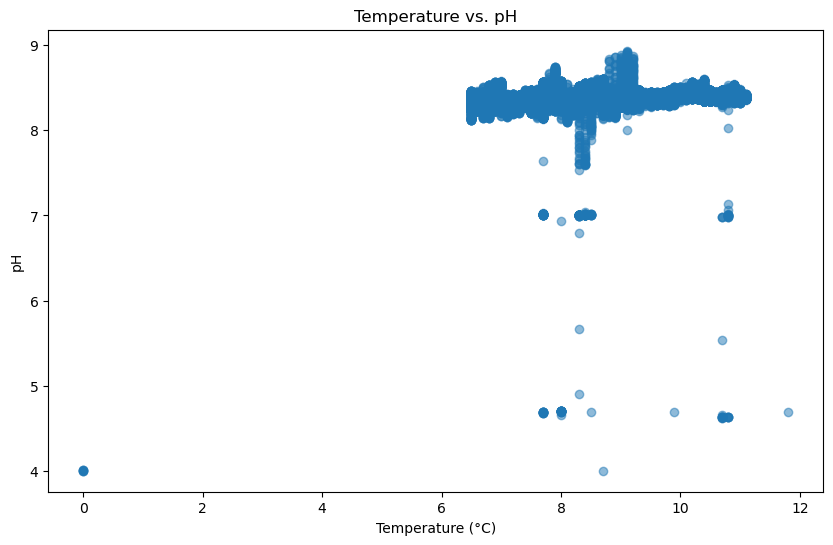

In [13]:
# Relationship between Temperature vs. pH
plt.figure(figsize=(10, 6))
plt.scatter(df['Tp'], df['pH'], alpha=0.5)
plt.title('Temperature vs. pH')
plt.xlabel('Temperature (°C)')
plt.ylabel('pH')
plt.show()


##### pH vs. Chlorine Dioxide Levels (Cl and Cl_2)

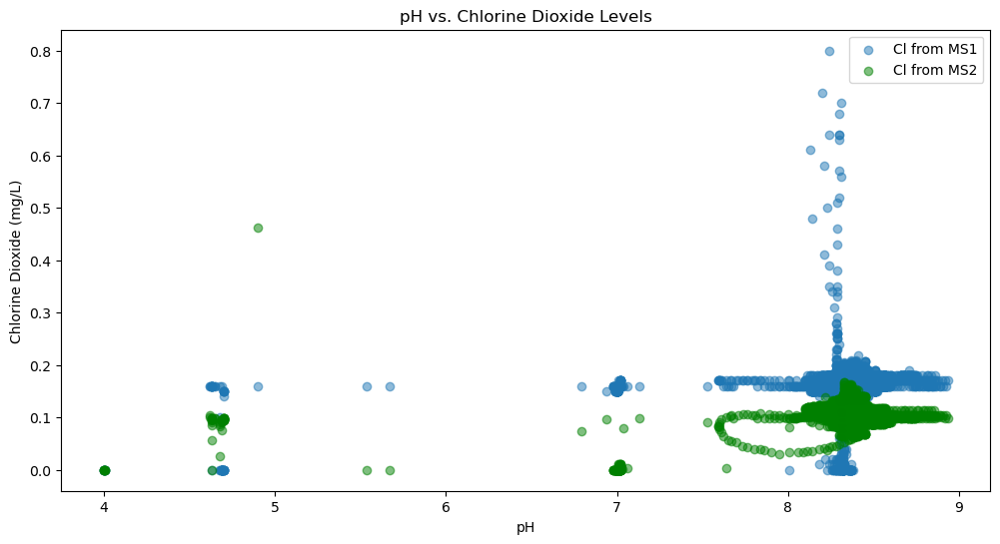

In [14]:
# pH vs. Chlorine Dioxide Levels (Cl and Cl_2)
plt.figure(figsize=(12, 6))
plt.scatter(df['pH'], df['Cl'], alpha=0.5, label='Cl from MS1')
plt.scatter(df['pH'], df['Cl_2'], alpha=0.5, label='Cl from MS2', color='green')
plt.title('pH vs. Chlorine Dioxide Levels')
plt.xlabel('pH')
plt.ylabel('Chlorine Dioxide (mg/L)')
plt.legend()
plt.show()


##### Redox Potential vs. pH

Understanding the relationship between redox potential and pH can be crucial for assessing the oxidative-reductive balance of the water, which impacts treatment processes and water quality.

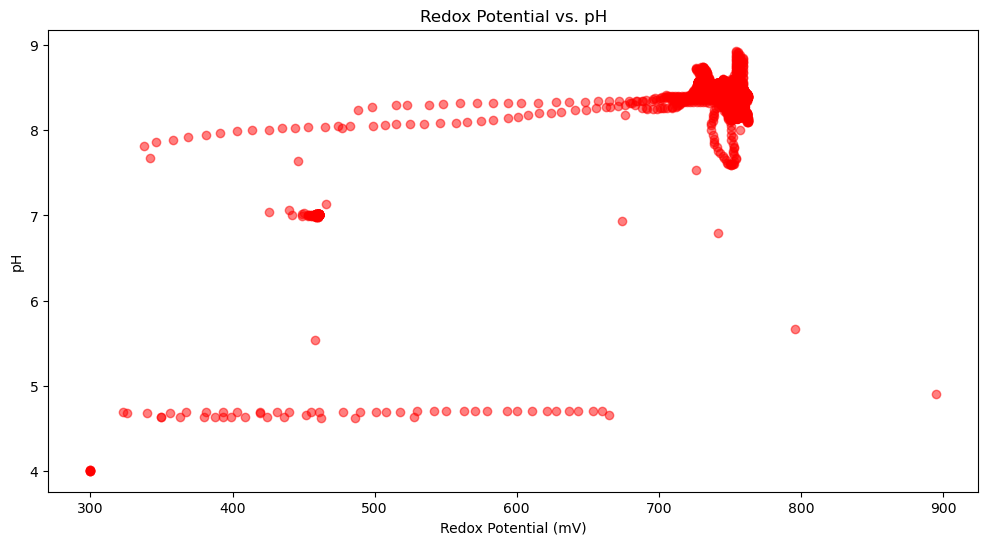

In [15]:
# Redox Potential vs. pH

plt.figure(figsize=(12, 6))
plt.scatter(df['Redox'], df['pH'], alpha=0.5, color='red')
plt.title('Redox Potential vs. pH')
plt.xlabel('Redox Potential (mV)')
plt.ylabel('pH')
plt.show()


#### 3. Boxplots for Distribution and Outliers


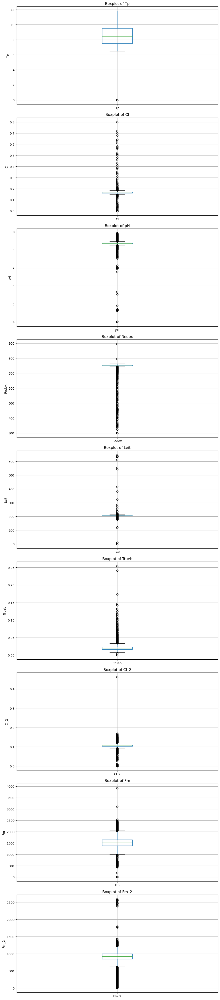

In [16]:
def plot_boxplots(df, columns):
    """
    This function creates a boxplot for each specified column in the dataframe.

    Parameters:
    df (pd.DataFrame): The dataframe containing the data.
    columns (list of str): List of column names to create boxplots for.

    Returns:
    None
    """
    num_plots = len(columns)
    fig, axes = plt.subplots(nrows=num_plots, figsize=(10, num_plots * 5))
    
    if num_plots == 1:
        axes = [axes]  # Make it iterable even if there's only one plot
    
    for ax, column in zip(axes, columns):
        df.boxplot(column=[column], ax=ax)
        ax.set_title(f'Boxplot of {column}')
        ax.set_ylabel(column)

    plt.tight_layout()
    plt.show()

# List of numeric columns you want to plot (adjust as necessary)
numeric_columns = ['Tp', 'Cl', 'pH', 'Redox', 'Leit', 'Trueb', 'Cl_2', 'Fm', 'Fm_2']
plot_boxplots(df, numeric_columns)

#### 4. Histograms for Variable Distributions


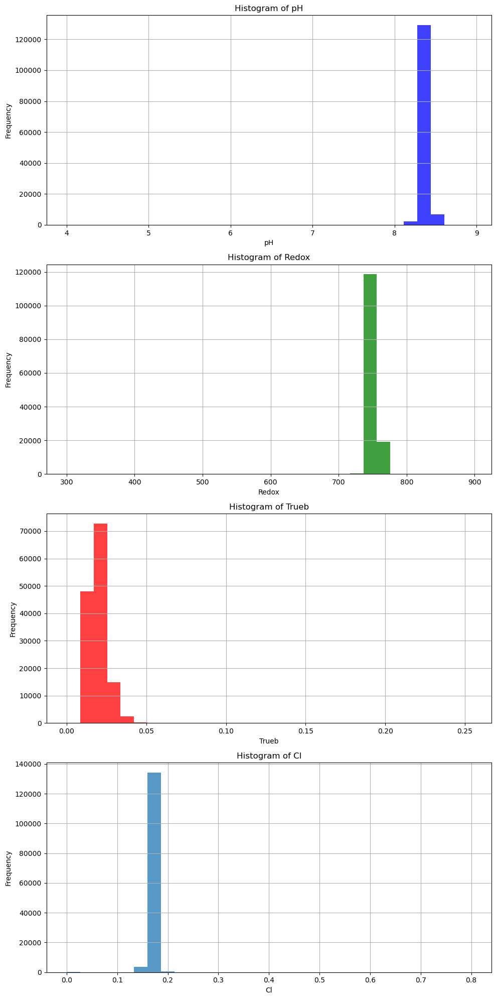

In [17]:
def plot_histograms(df, columns, bins=30, color=None):
    """
    This function creates a histogram for each specified column in the dataframe.

    Parameters:
    df (pd.DataFrame): The dataframe containing the data.
    columns (list of str): List of column names to create histograms for.
    bins (int): Number of bins for the histogram.
    color (str or list): Color for the histograms or a list of colors, one for each histogram.

    Returns:
    None
    """
    num_plots = len(columns)
    fig, axes = plt.subplots(nrows=num_plots, figsize=(10, num_plots * 5))

    if num_plots == 1:
        axes = [axes]  # Make it iterable even if there's only one plot

    # Setting colors for each histogram if multiple are provided
    if not isinstance(color, list):
        color = [color] * num_plots  # Extend the single color to all plots
    else:
        color = color + [None] * (num_plots - len(color))  # Ensure enough colors are provided

    for ax, column, col in zip(axes, columns, color):
        df[column].hist(bins=bins, ax=ax, color=col, alpha=0.75)
        ax.set_title(f'Histogram of {column}')
        ax.set_xlabel(column)
        ax.set_ylabel('Frequency')

    plt.tight_layout()
    plt.show()

# List of columns to plot histograms for
measure_columns = ['pH', 'Redox', 'Trueb', 'Cl']
plot_histograms(df, measure_columns, bins=30, color=['blue', 'green', 'red'])

#### 5. Plotting Anomalies in Data


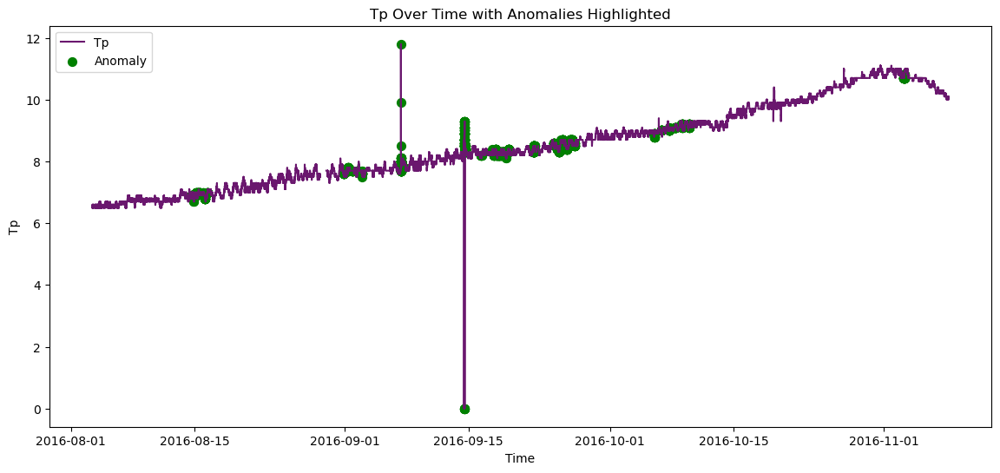

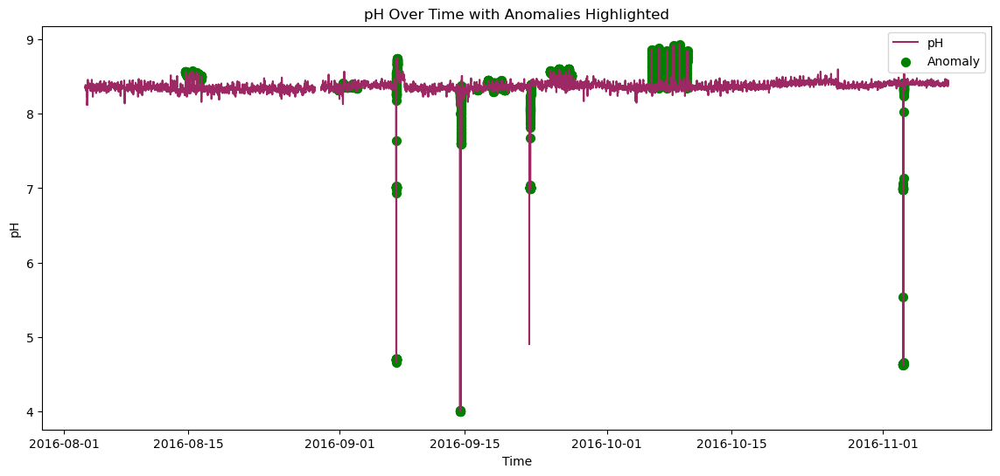

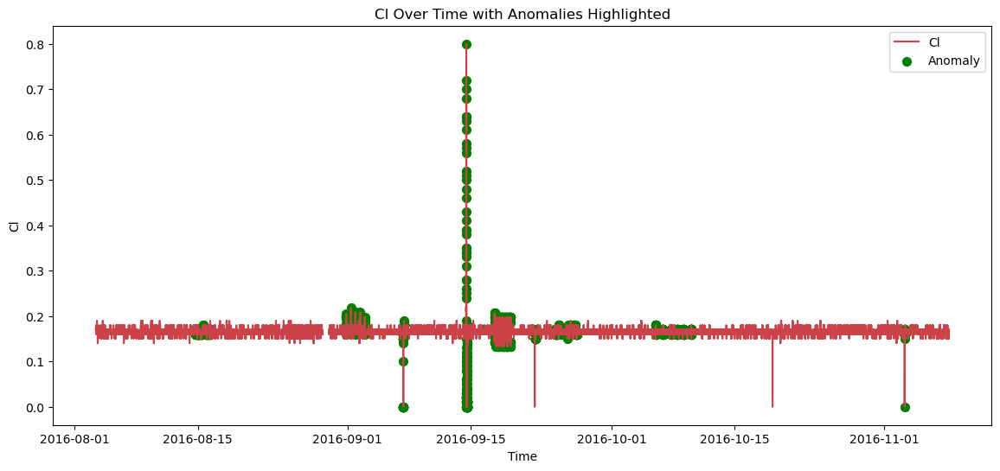

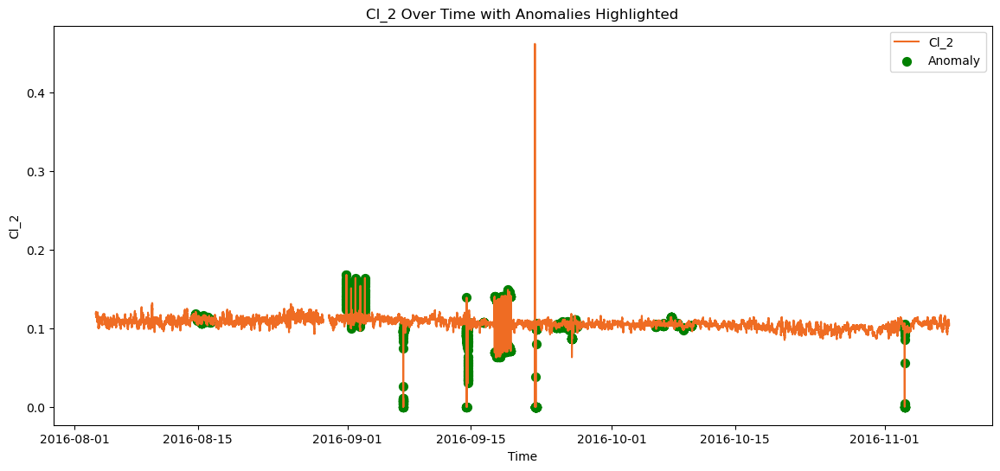

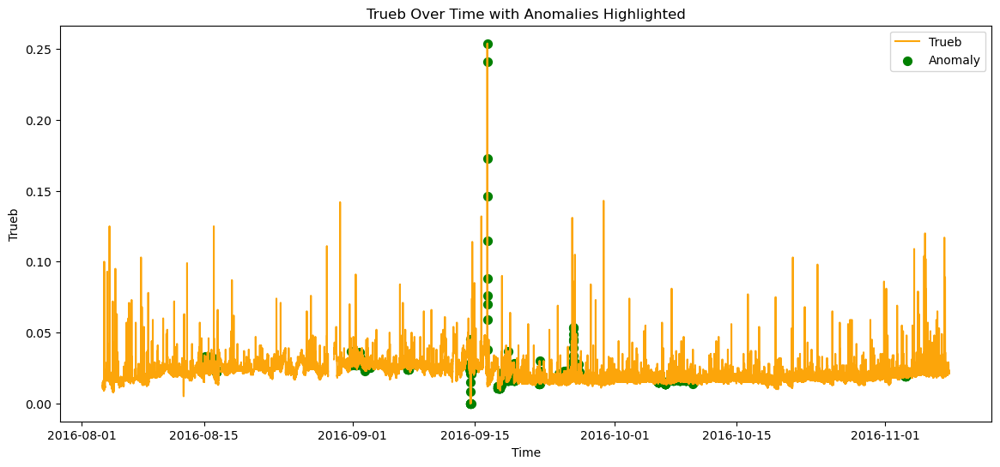

In [19]:
def plot_time_series_with_anomalies(df, columns, time_column='Time', event_column='EVENT'):
    """
    This function creates time series plots for specified columns and highlights anomalies.
    
    Parameters:
    df (pd.DataFrame): The dataframe containing the data.
    columns (list of str): List of column names to create time series plots for.
    time_column (str): The column name which contains the time data.
    event_column (str): The column name which marks anomalies as True/False.
    
    Returns:
    None
    """
    # Ensure 'Time' is in datetime format for better plotting
    if not pd.api.types.is_datetime64_any_dtype(df[time_column]):
        df[time_column] = pd.to_datetime(df[time_column])

    # Define a color palette for the time series
    color_palette = plt.cm.inferno(np.linspace(0.3, 0.8, len(columns)))

    # Plotting each column with anomalies highlighted
    for column, color in zip(columns, color_palette):
        plt.figure(figsize=(14, 6))
        plt.plot(df[time_column], df[column], label=f'{column}', color=color)
        plt.scatter(df[df[event_column]][time_column], df[df[event_column]][column], color='green', label='Anomaly', s=50)  # Anomalies in green
        plt.title(f'{column} Over Time with Anomalies Highlighted')
        plt.xlabel('Time')
        plt.ylabel(column)
        plt.legend()
        plt.show()

# List of columns you want to plot with anomalies
columns_to_plot = ['Tp', 'pH', 'Cl', 'Cl_2', 'Trueb']
plot_time_series_with_anomalies(df, columns_to_plot)

###### (Optional) Interactive plot with Plotly

In [20]:
import plotly.graph_objects as go
import pandas as pd

def plot_time_series_with_anomalies_interactive(df, columns, time_column='Time', event_column='EVENT'):
    """
    This function creates interactive time series plots for specified columns and highlights anomalies.

    Parameters:
    df (pd.DataFrame): The dataframe containing the data.
    columns (list of str): List of column names to create time series plots for.
    time_column (str): The column name which contains the time data.
    event_column (str): The column name which marks anomalies as True/False.

    Returns:
    None
    """
    # Ensure 'Time' is in datetime format for better plotting
    if not pd.api.types.is_datetime64_any_dtype(df[time_column]):
        df[time_column] = pd.to_datetime(df[time_column])

    # Plotting each column with anomalies highlighted
    for column in columns:
        fig = go.Figure()

        # Main time series plot
        fig.add_trace(go.Scatter(x=df[time_column], y=df[column], mode='lines', name=column))

        # Anomalies as scatter points
        anomaly_data = df[df[event_column]]
        fig.add_trace(go.Scatter(x=anomaly_data[time_column], y=anomaly_data[column],
                                 mode='markers', name='Anomaly', marker=dict(color='green', size=10)))

        # Layout settings
        fig.update_layout(title=f'{column} Over Time with Anomalies Highlighted',
                          xaxis_title='Time',
                          yaxis_title=column,
                          legend_title='Legend',
                          xaxis_rangeslider_visible=True)
        fig.show()

# List of columns you want to plot with anomalies
columns_to_plot = ['Tp', 'pH', 'Cl', 'Cl_2', 'Trueb']
plot_time_series_with_anomalies_interactive(df, columns_to_plot)


#### 6. Correlation Matrix


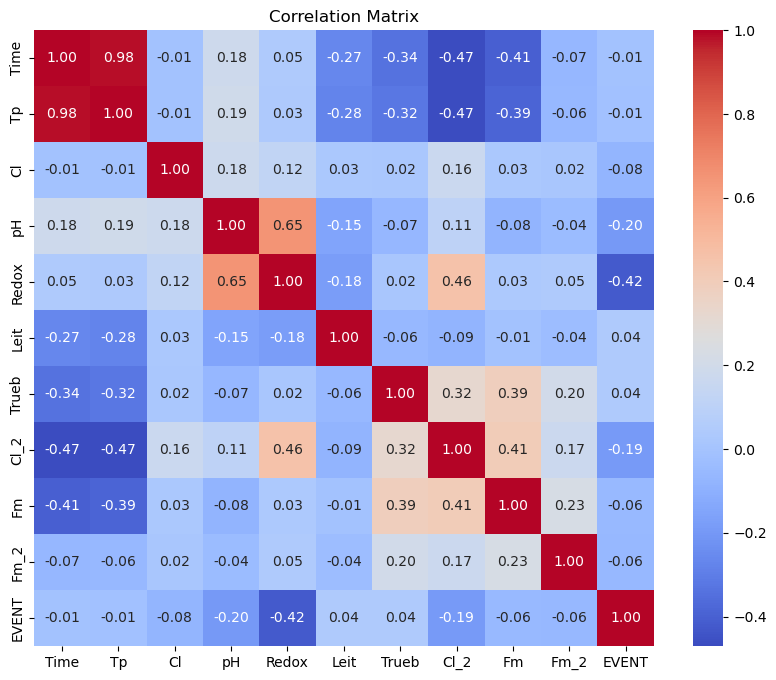

In [24]:
import seaborn as sns

# Compute the correlation matrix
corr = df.corr()

# Generate a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr, annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()


##### Interpret of Correlation Matrix


- Time and Temperature (`Tp`)
  - Correlation: 0.98
  - This is a very high positive correlation, indicating that as time progresses, temperature also increases signigicantly. This could suggest a trend over time or that the measurements were taken over a period with rising temperatures.
- `pH` and `Redox`
  - Corr: 0.65
  - This indicates that as pH increases, the redox potential also tends to increase.
- `Cl_2` and Redox
  - Corr: 0.45
  - A moderate positive correlation suggests that increases in chlorine dioxide measurements from MS2 are associated with increases in redox potential.
- `Trueb` and `Fm`
  - Corr: 0.39
  - This moderate positive correlation implies that higher turbidity are associated with higher flow rates at water line 1.

Negative Correlations:
- `Leit` and `Tp`
  - Corr: -0.28
  - A negative correlation suggests that the temperature increases, the electrical conductivity decreases.

Correlations Involving `EVENT`
- `Redox` and `EVENT`
  - Corr: -0.41
  - A moderate negative correlation suggests that lower redox potentials are associated with the occurrences labeled as events (anomalies). This might indicate that certain types of anomalies are linked to reduced oxidation-reduction activity.
- `pH` and `EVENT`
  - Corr: -0.19
  - A weaker negative correlation, indicating that lower pH values tend to coincide with anomalies. This could suggest that more acidic conditions might be related to undesirable or anomalous water quality events.